In [1]:
import warnings
warnings.filterwarnings("ignore")

import matplotlib.pyplot as plt
%matplotlib inline

import sys
import os

import numpy as np
import cv2
import h5py

from keras.models import Model
from keras.layers import Input, Lambda
from keras.layers.normalization import BatchNormalization
from keras.layers.convolutional import UpSampling2D, Conv2D
from keras.layers.advanced_activations import LeakyReLU
from keras.layers import concatenate
from keras.optimizers import Adam
from keras import backend as K

from skimage.measure import compare_psnr

Using TensorFlow backend.


In [2]:
import numpy as np

import tensorflow
import keras

from keras.models import Sequential, Model
from keras.engine.input_layer import Input
from keras.layers import Dense, Conv2D, BatchNormalization, LeakyReLU, Lambda, Concatenate

# credit to: https://github.com/sabakanation/DeepImagePrior
def reflection_padding(x, padding):
    reflected = Lambda(lambda x: x[:, :, ::-1, :])(x)
    reflected = Lambda(lambda x: x[:, :, :padding[1], :])(reflected)
    upper_row = concatenate([x, reflected], axis=2)
    lower_row = Lambda(lambda x: x[:, ::-1, :, :])(upper_row)
    lower_row = Lambda(lambda x: x[:, :padding[0], :, :])(lower_row)
    padded = concatenate([upper_row, lower_row], axis=1)
    return padded

def get_layer_size(x):
    height, width = x.get_shape()[1:3]
    height = int(height)
    width = int(width)
    return [height, width]

def Conv_BN_Act(layer, num_channels=128, kernel_size=3, strides=(1,1)):
    size = get_layer_size(layer)

    padding = [0, 0]
    padding[0] = (int(size[0]/strides[0]) - 1) * strides[0] + kernel_size - size[0]
    padding[1] = (int(size[1]/strides[1]) - 1) * strides[1] + kernel_size - size[1]
    layer = reflection_padding(layer, padding)

    layer = Conv2D(num_channels, kernel_size, strides=strides, padding='valid', activation=None)(layer)
    layer = BatchNormalization()(layer)
    layer = LeakyReLU(alpha=0.2)(layer)

    return layer

# mostly based on: https://github.com/beala/deep-image-prior-tensorflow
def down_layer(layer, num_channels=128, kernel_size=3):
    size = get_layer_size(layer)
    if size[0] % 2 != 0:
        layer = reflection_padding(layer, [1, 0])
    if size[1] % 2 != 0:
        layer = reflection_padding(layer, [0, 1])

    layer = Conv_BN_Act(layer, num_channels, kernel_size, (2, 2))
    layer = Conv_BN_Act(layer, num_channels, kernel_size, (1, 1))
    
    return layer

def up_layer(layer, num_channels=128, kernel_size=3, inter="bilinear"):
    layer = UpSampling2D(size=(2, 2))(layer)

    if inter == "bilinear":
        layer_padded = reflection_padding(layer, (1, 1))
        layer = Lambda(lambda x: (x[:, :-1, 1:, :] + x[:, 1:, :-1, :] + x[:, :-1, :-1, :] + x[:, :-1, :-1, :]) / 4.0)(layer_padded)

    layer = Conv_BN_Act(layer, num_channels, kernel_size, (1, 1))
    layer = Conv_BN_Act(layer, num_channels, 1, (1, 1))
    
    return layer

def skip(layer, num_channels=4, kernel_size=1):
    layer = Conv_BN_Act(layer, num_channels, kernel_size, (1, 1))
    return layer

def build_model(input_shape, num_depth, down_channels, up_channels, down_kernel, up_kernel, skip_channel, skip_kernel, inter):
    input_layer = Input(shape=input_shape)

    # Connect up all the downsampling layers.
    skips = []
    layer = input_layer
    size = get_layer_size(layer)
    sizes = [size]
    for i in range(num_depth):
        layer = down_layer(layer, down_channels[i], down_kernel[i])
        size = get_layer_size(layer)
        sizes.append(size)
        if skip_channel[i] != 0:
            skips.append(skip(layer, skip_channel[i], skip_kernel[i]))
        else:
            skips.append(None)
    print("Shape after downsample: " + str(layer.get_shape()))

    # Connect up the upsampling layers, from smallest to largest.
    for i in range(num_depth-1, -1, -1):
        if skip_channel[i] != 0:
            layer = concatenate([layer, skips[i]], axis=3)
        layer = up_layer(layer, up_channels[i], up_kernel[i], inter)
        size = get_layer_size(layer)

        if sizes[i] != size:
            layer = Lambda(lambda x: x[:, :sizes[i][0], :sizes[i][1], :])(layer)

    print("Shape after upsample: " + str(layer.get_shape()))

    # Restore original image dimensions and channels
    output_layer = Conv2D(3, 1, strides=1, padding='valid', activation=None)(layer)
    print("Output shape: " + str(output_layer.get_shape()))
    
    model = Model(inputs=input_layer, outputs=output_layer)

    return model

In [3]:
def define_inpainting_model(height, width):
    input_shape = (height, width, 2)
    num_depth = 5
    up_channels = [128, 128, 128, 128, 128]
    down_channels = [128, 128, 128, 128, 128]
    up_kernel = [3, 3, 3, 3, 3]
    down_kernel = [3, 3, 3, 3, 3]
    skip_channel = [0, 0, 0, 0, 0]
    skip_kernel = [0, 0, 0, 0, 0]
    lr = 0.01
    inter = "bilinear"

    base_model = build_model(input_shape, num_depth, down_channels, up_channels, down_kernel, up_kernel, skip_channel, skip_kernel, inter)
    
    masked_image = Input(shape=(height, width, 3))
    mask_image = Input(shape=(height, width, 1))

    loss = Lambda(lambda x: K.sum(K.square((x[0] - x[1]) * x[2]), axis=-1))([base_model.output, masked_image, mask_image])

    model = Model([base_model.input, masked_image, mask_image], loss)
    model.compile(loss="mean_absolute_error", optimizer=Adam(lr=lr))

    return model, base_model


# def inpainting(masked_image, mask_image):
#     height, width = masked_image.shape[:2]
#     model, base_model = define_inpainting_model(height, width)

#     y = np.linspace(0.0, 1.0, height)
#     x = np.linspace(0.0, 1.0, width)
#     XX, YY = np.meshgrid(x, y)
#     input_meshgrid = np.concatenate([XX[:,:,None], YY[:,:,None]], axis=2)

#     for i in range(5000):
#         model.train_on_batch([input_meshgrid[None, :, :, :], masked_image[None, :, :, :], mask_image[None, :, :, None]], np.zeros((1, 320, 320)))

#     inpainted_image = np.clip(base_model.predict(input_meshgrid[None, :, :, :])[0], 0, 255).astype(np.uint8)
#     return (masked_image * mask_image[:, :, None] + inpainted_image * (1 - mask_image[:, :, None])).astype(np.uint8)



In [4]:
masked_name = 'data/inpainting/library_masked.png'
mask_name = 'data/inpainting/library_mask.png'
fname = 'data/inpainting/library.png'
# inpainted_name = sys.argv[3]

image = cv2.imread(fname)
masked_image = cv2.imread(masked_name)
mask_image = cv2.imread(mask_name, cv2.IMREAD_GRAYSCALE) / 255.0
# inpainted_image = inpainting(masked_image, mask_image)
# cv2.imwrite(inpainted_name, inpainted_image)

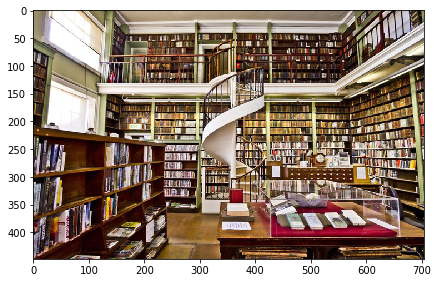

In [5]:
plt.figure(figsize=(7, 7))
plt.imshow(image[:,:,::-1])
plt.show()

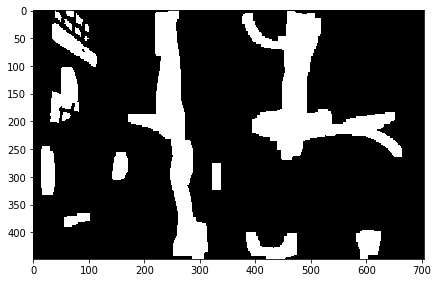

In [6]:
plt.figure(figsize=(7, 7))
plt.imshow(mask_image, cmap="Greys")
plt.show()

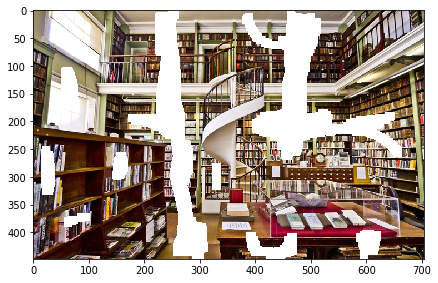

In [7]:
plt.figure(figsize=(7, 7))
plt.imshow(masked_image[:,:,::-1])
plt.show()

In [9]:
height, width = masked_image.shape[:2]
print(height, width)

448 704


In [11]:
model, base_model = define_inpainting_model(height, width)

y = np.linspace(0.0, 1.0, height)
x = np.linspace(0.0, 1.0, width)
XX, YY = np.meshgrid(x, y)
input_meshgrid = np.concatenate([XX[:,:,None], YY[:,:,None]], axis=2)

Shape after downsample: (?, 14, 22, 128)
Shape after upsample: (?, 448, 704, 128)
Output shape: (?, 448, 704, 3)


In [12]:
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            (None, 448, 704, 2)  0                                            
__________________________________________________________________________________________________
lambda_107 (Lambda)             (None, 448, 704, 2)  0           input_4[0][0]                    
__________________________________________________________________________________________________
lambda_108 (Lambda)             (None, 448, 1, 2)    0           lambda_107[0][0]                 
__________________________________________________________________________________________________
concatenate_51 (Concatenate)    (None, 448, 705, 2)  0           input_4[0][0]                    
                                                                 lambda_108[0][0]                 
__________

In [13]:
base_model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            (None, 448, 704, 2)  0                                            
__________________________________________________________________________________________________
lambda_107 (Lambda)             (None, 448, 704, 2)  0           input_4[0][0]                    
__________________________________________________________________________________________________
lambda_108 (Lambda)             (None, 448, 1, 2)    0           lambda_107[0][0]                 
__________________________________________________________________________________________________
concatenate_51 (Concatenate)    (None, 448, 705, 2)  0           input_4[0][0]                    
                                                                 lambda_108[0][0]                 
__________

Iter # 0 , PSRN NOISY:  8.580728216097466 ; PSRN GT:  12.651922639458867


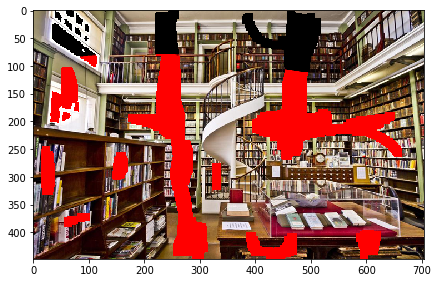

Iter # 20 , PSRN NOISY:  inf ; PSRN GT:  11.42493808115108


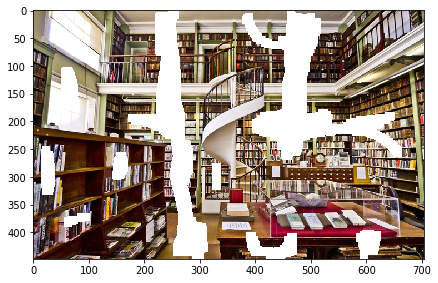

Iter # 40 , PSRN NOISY:  18.17641472402569 ; PSRN GT:  10.757175023219752


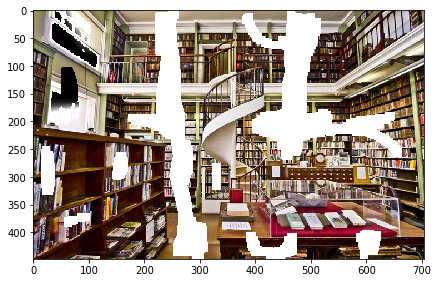

Iter # 60 , PSRN NOISY:  15.385667346142897 ; PSRN GT:  13.046669526180727


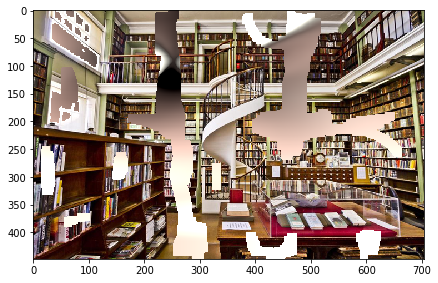

Iter # 80 , PSRN NOISY:  8.530253767088519 ; PSRN GT:  13.536485089763344


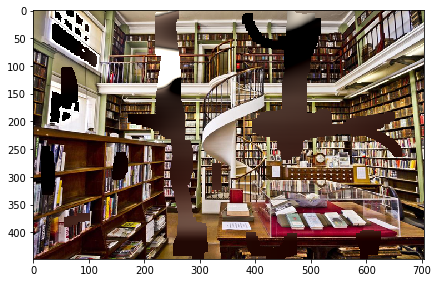

Iter # 100 , PSRN NOISY:  14.156327310063022 ; PSRN GT:  13.585386104984975


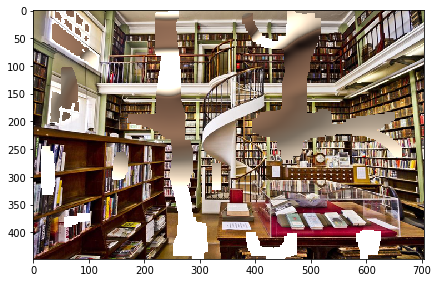

Iter # 120 , PSRN NOISY:  14.31616284651403 ; PSRN GT:  13.081231947377162


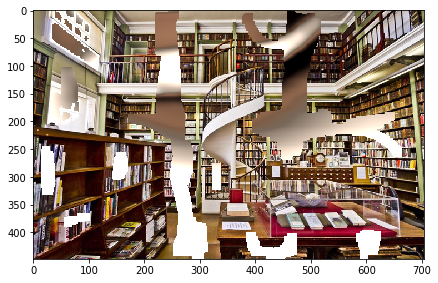

Iter # 140 , PSRN NOISY:  12.965482993276439 ; PSRN GT:  14.05176053283721


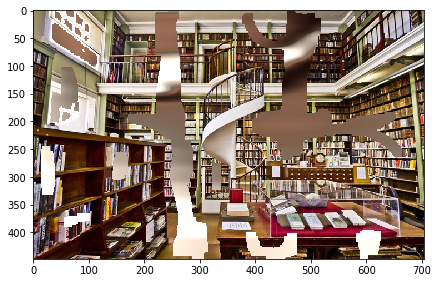

Iter # 160 , PSRN NOISY:  13.965005405169833 ; PSRN GT:  13.959991988211469


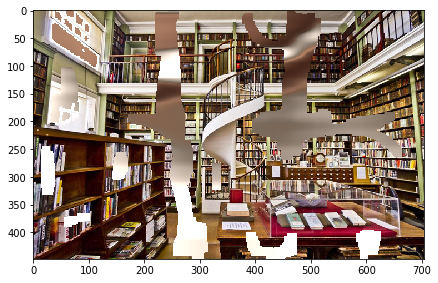

Iter # 180 , PSRN NOISY:  11.9260629229228 ; PSRN GT:  16.44256100368127


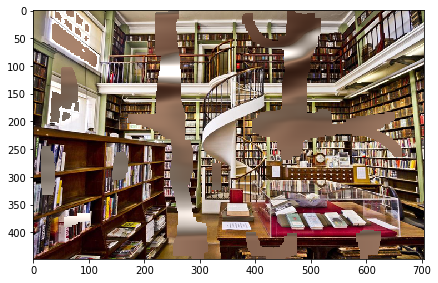

Iter # 200 , PSRN NOISY:  11.03268345110459 ; PSRN GT:  16.560410872956435


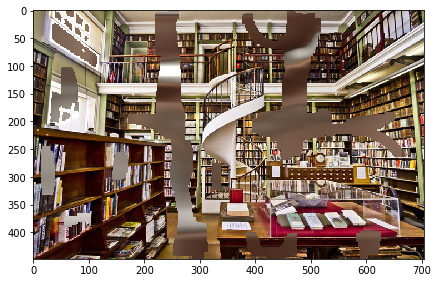

Iter # 220 , PSRN NOISY:  10.373880516550457 ; PSRN GT:  15.939145439234434


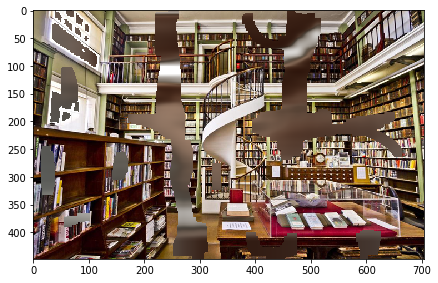

Iter # 240 , PSRN NOISY:  11.40275739997982 ; PSRN GT:  16.417370652108005


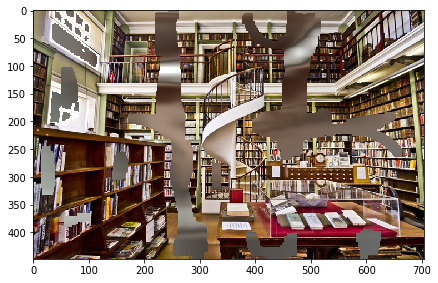

Iter # 260 , PSRN NOISY:  11.138220798048646 ; PSRN GT:  16.92985740205164


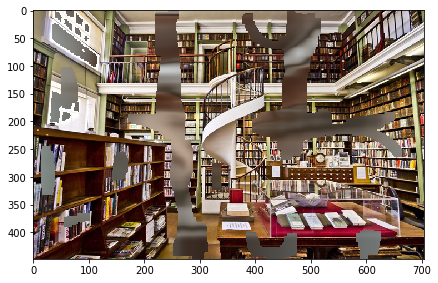

Iter # 280 , PSRN NOISY:  12.04502099320088 ; PSRN GT:  16.57586772258055


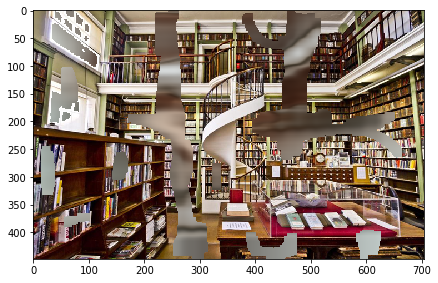

Iter # 300 , PSRN NOISY:  13.585939951461583 ; PSRN GT:  15.329949543685169


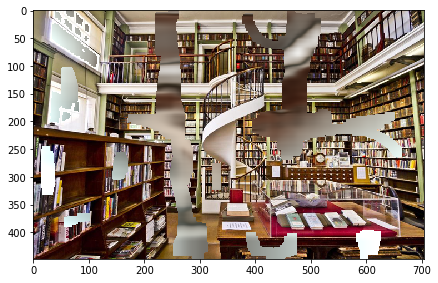

Iter # 320 , PSRN NOISY:  13.243170086456006 ; PSRN GT:  15.118626108949062


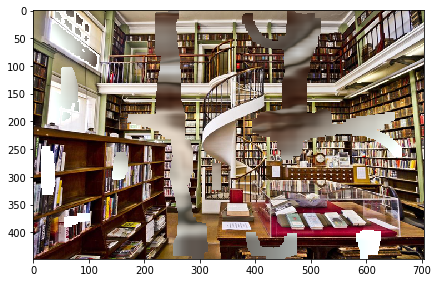

Iter # 340 , PSRN NOISY:  13.972656934945602 ; PSRN GT:  14.34879046533136


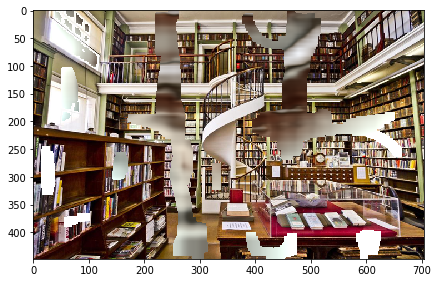

Iter # 360 , PSRN NOISY:  12.804785317009484 ; PSRN GT:  15.345509386118454


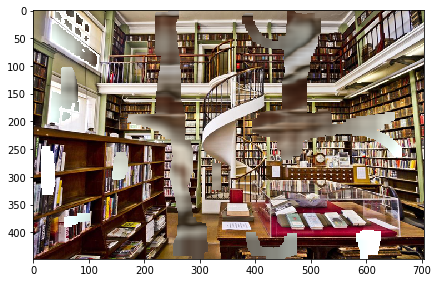

Iter # 380 , PSRN NOISY:  12.083657780246204 ; PSRN GT:  15.763436142592958


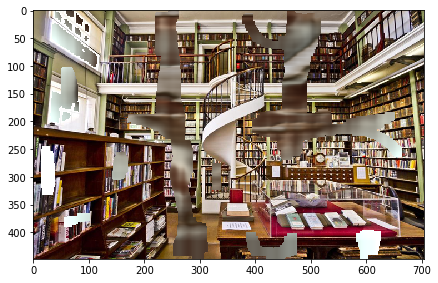

Iter # 400 , PSRN NOISY:  12.297413267848626 ; PSRN GT:  15.456388329103172


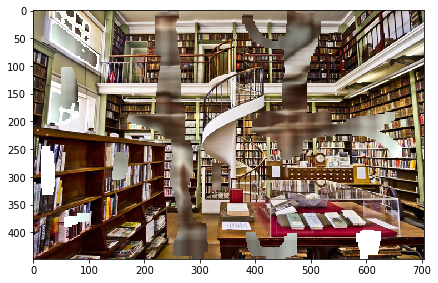

Iter # 420 , PSRN NOISY:  11.816454931079898 ; PSRN GT:  15.482660781572976


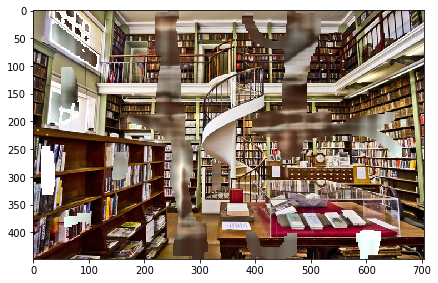

Iter # 440 , PSRN NOISY:  12.445442551536456 ; PSRN GT:  15.118007046614059


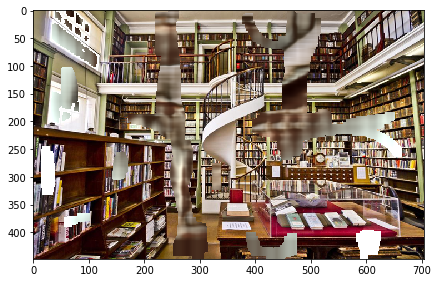

Iter # 460 , PSRN NOISY:  12.330642301178923 ; PSRN GT:  15.102239402415737


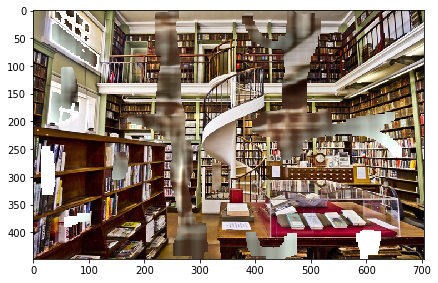

Iter # 480 , PSRN NOISY:  12.195387405359595 ; PSRN GT:  14.739841850059616


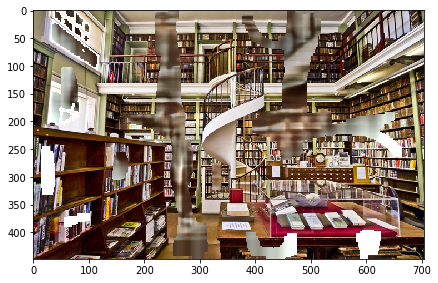

Iter # 500 , PSRN NOISY:  11.395619576372853 ; PSRN GT:  15.08812961515883


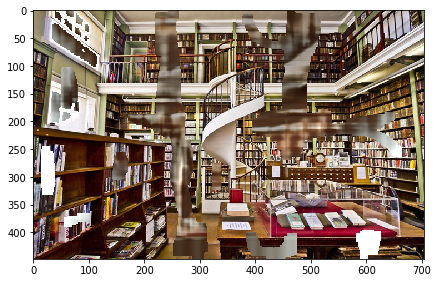

Iter # 520 , PSRN NOISY:  10.749790547822045 ; PSRN GT:  14.925523403446244


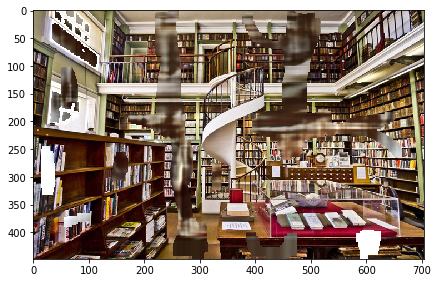

Iter # 540 , PSRN NOISY:  11.41580646102417 ; PSRN GT:  14.852048354042227


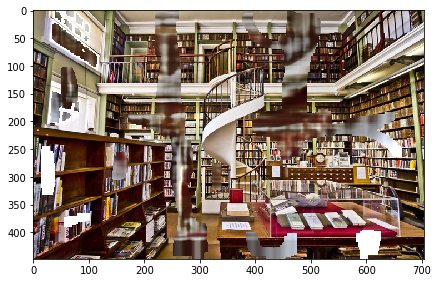

Iter # 560 , PSRN NOISY:  11.025824086409536 ; PSRN GT:  14.862905691897081


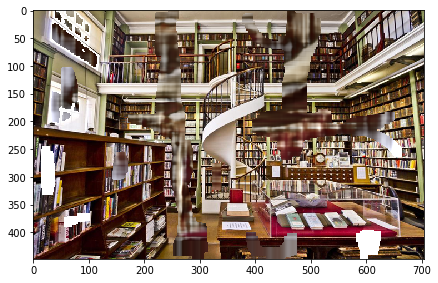

Iter # 580 , PSRN NOISY:  11.006080048874026 ; PSRN GT:  14.831319625947243


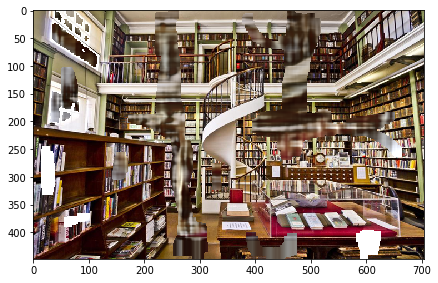

Iter # 600 , PSRN NOISY:  10.582430844094862 ; PSRN GT:  15.599485081262692


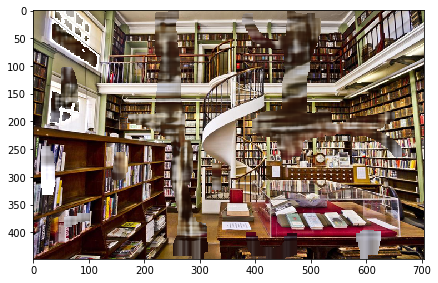

Iter # 620 , PSRN NOISY:  10.363297093560215 ; PSRN GT:  15.693651564547565


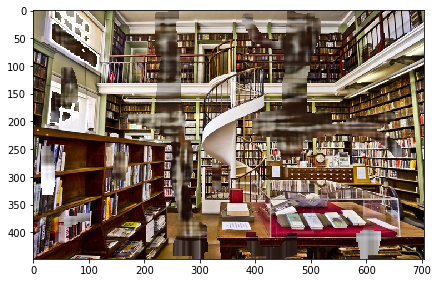

Iter # 640 , PSRN NOISY:  10.192398898765871 ; PSRN GT:  16.024286918164414


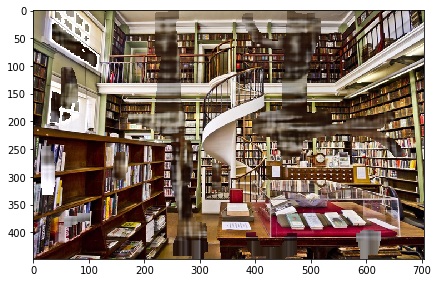

Iter # 660 , PSRN NOISY:  9.96835846769035 ; PSRN GT:  16.265724297080343


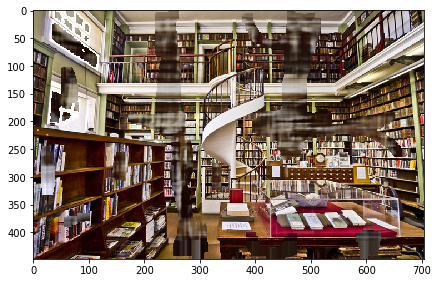

Iter # 680 , PSRN NOISY:  9.820116515712494 ; PSRN GT:  16.511381774406416


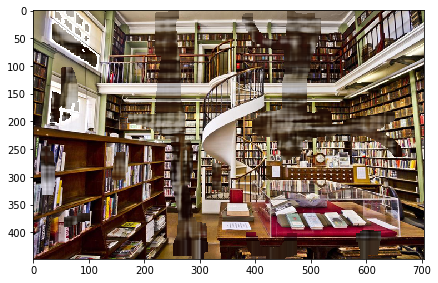

Iter # 700 , PSRN NOISY:  9.77597992815415 ; PSRN GT:  16.53371735801153


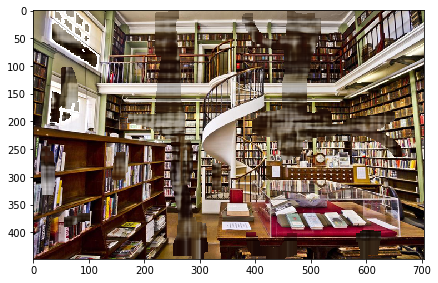

Iter # 720 , PSRN NOISY:  9.804478899306655 ; PSRN GT:  16.786020524437543


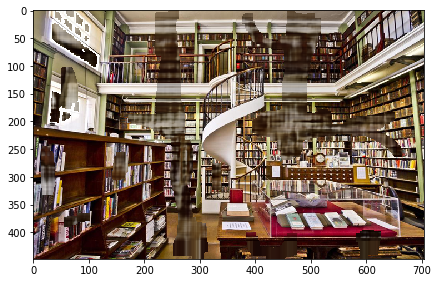

Iter # 740 , PSRN NOISY:  9.815151806504476 ; PSRN GT:  17.024286444942565


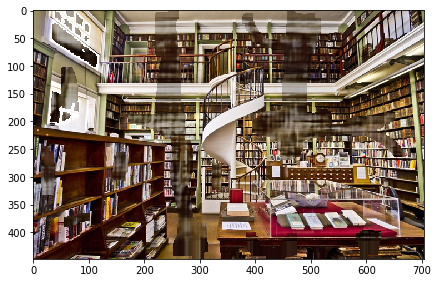

Iter # 760 , PSRN NOISY:  9.872075904964516 ; PSRN GT:  17.411958695248543


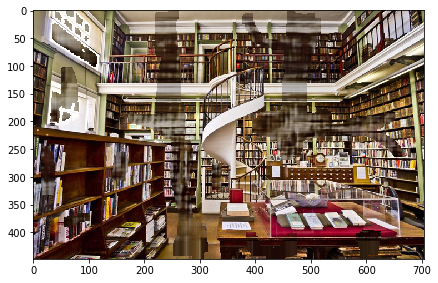

Iter # 780 , PSRN NOISY:  10.77868711153064 ; PSRN GT:  16.834332833953372


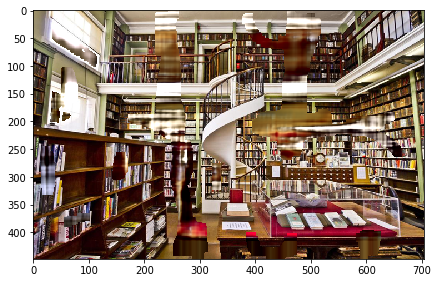

Iter # 800 , PSRN NOISY:  11.101565695120676 ; PSRN GT:  16.10016306995121


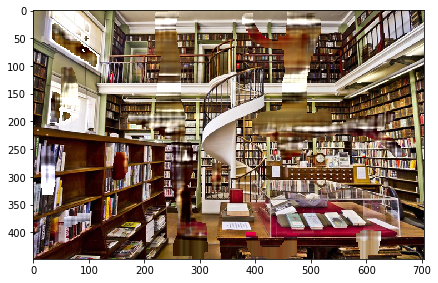

Iter # 820 , PSRN NOISY:  10.305532426189561 ; PSRN GT:  16.27209044473452


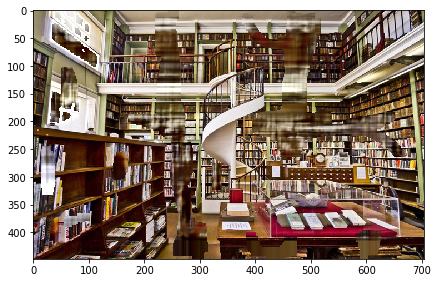

Iter # 840 , PSRN NOISY:  10.47845991447957 ; PSRN GT:  15.02028989674767


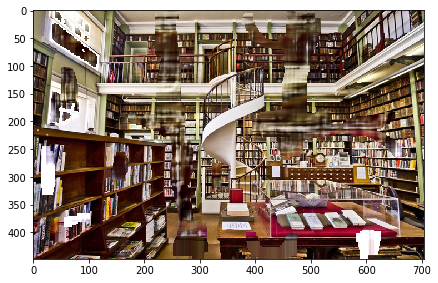

Iter # 860 , PSRN NOISY:  10.25279801937927 ; PSRN GT:  15.258647932030252


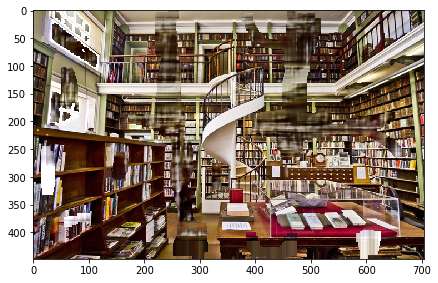

Iter # 880 , PSRN NOISY:  10.089805266621642 ; PSRN GT:  15.667471607275372


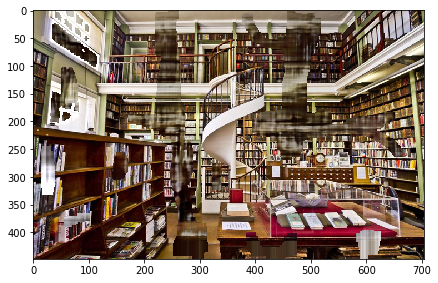

Iter # 900 , PSRN NOISY:  9.91392006777622 ; PSRN GT:  16.157185723502216


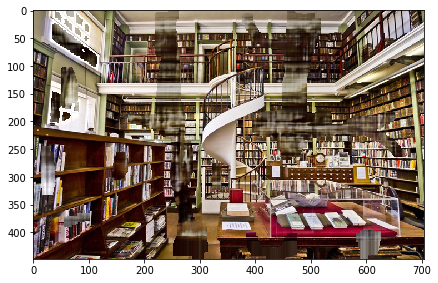

Iter # 920 , PSRN NOISY:  9.968882066152313 ; PSRN GT:  16.705101129620115


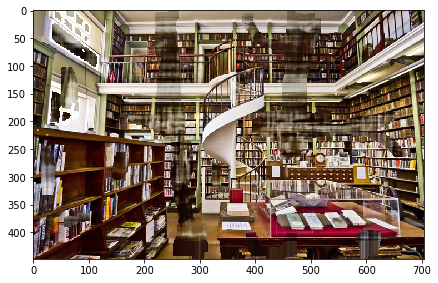

Iter # 940 , PSRN NOISY:  10.03812241065133 ; PSRN GT:  17.203283740877982


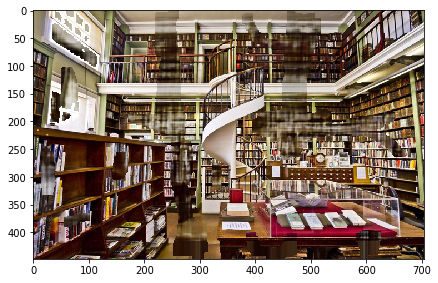

Iter # 960 , PSRN NOISY:  10.204339663819708 ; PSRN GT:  17.606067796431564


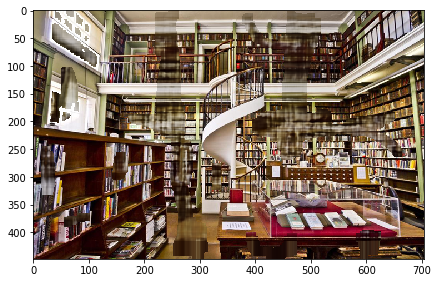

Iter # 980 , PSRN NOISY:  10.129737523014615 ; PSRN GT:  17.687572323353624


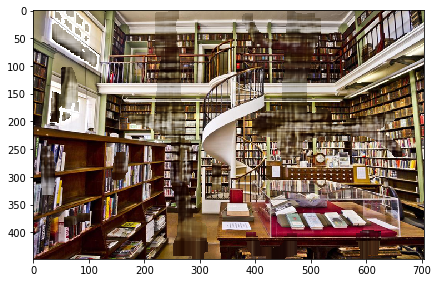

Iter # 1000 , PSRN NOISY:  10.295940997298613 ; PSRN GT:  18.09552023679306


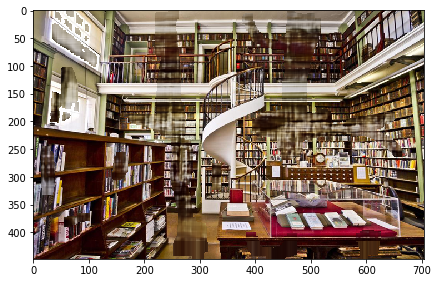

Iter # 1020 , PSRN NOISY:  10.250751505779043 ; PSRN GT:  17.82942751709749


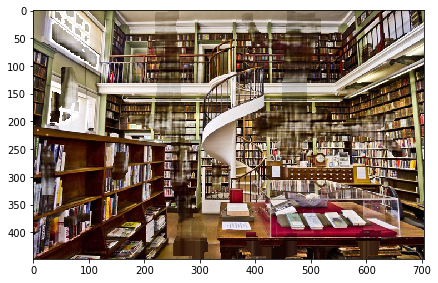

Iter # 1040 , PSRN NOISY:  10.351327371947033 ; PSRN GT:  18.220469799197467


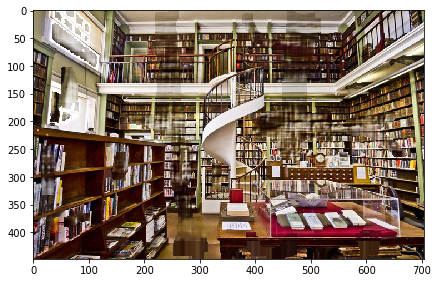

Iter # 1060 , PSRN NOISY:  10.375790235961075 ; PSRN GT:  18.23712817751267


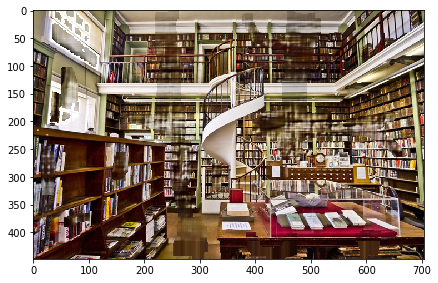

Iter # 1080 , PSRN NOISY:  10.498446275254935 ; PSRN GT:  18.708265182976323


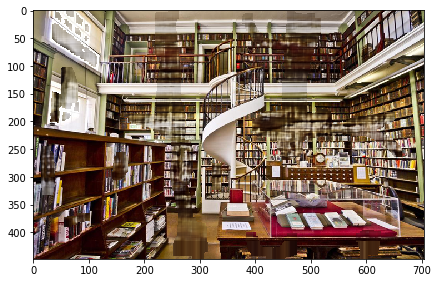

Iter # 1100 , PSRN NOISY:  10.588317537214923 ; PSRN GT:  18.618419505892923


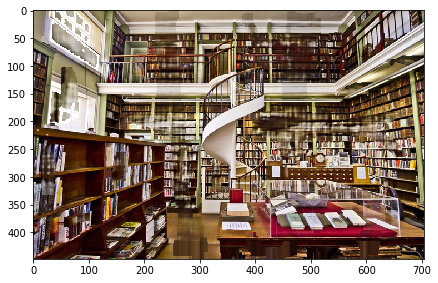

Iter # 1120 , PSRN NOISY:  10.580997301184343 ; PSRN GT:  18.987201316440135


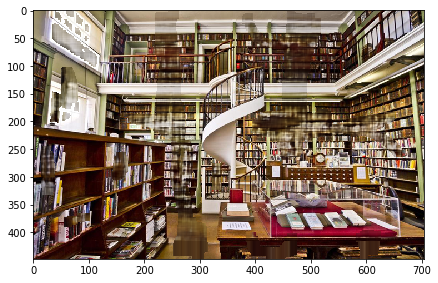

Iter # 1140 , PSRN NOISY:  10.835356283952372 ; PSRN GT:  17.51855431107304


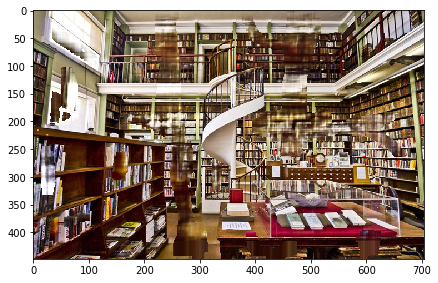

Iter # 1160 , PSRN NOISY:  10.923230900514211 ; PSRN GT:  15.928071870918835


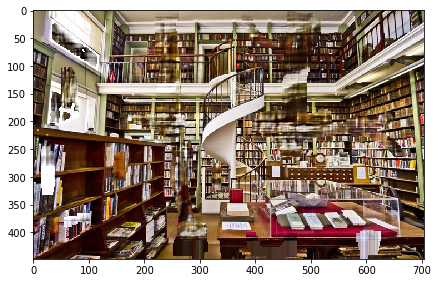

Iter # 1180 , PSRN NOISY:  10.753465107185939 ; PSRN GT:  16.76257160779634


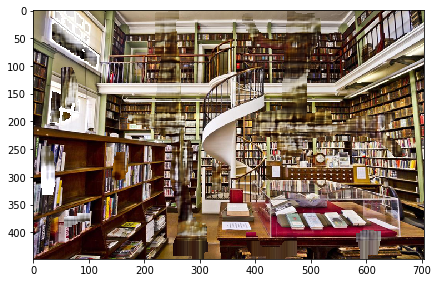

Iter # 1200 , PSRN NOISY:  10.500996103396854 ; PSRN GT:  17.341661143720188


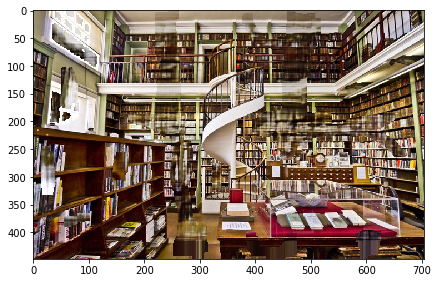

Iter # 1220 , PSRN NOISY:  10.489828806519302 ; PSRN GT:  17.650792563126497


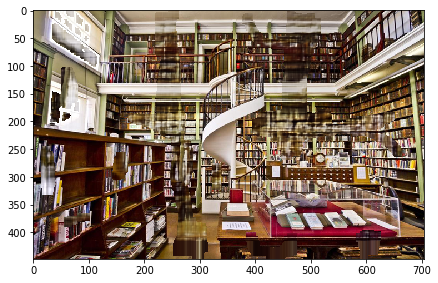

Iter # 1240 , PSRN NOISY:  10.498801902892303 ; PSRN GT:  18.030830262880556


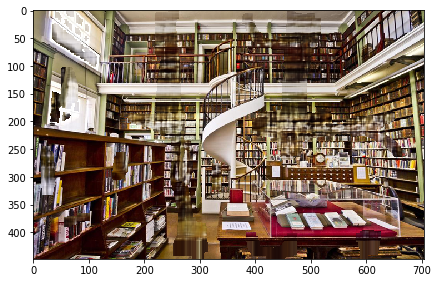

Iter # 1260 , PSRN NOISY:  10.702263991628646 ; PSRN GT:  18.543951182229684


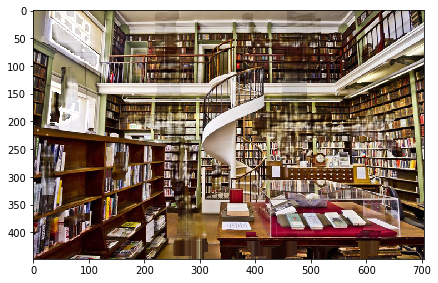

Iter # 1280 , PSRN NOISY:  10.705421320311014 ; PSRN GT:  18.535950880523085


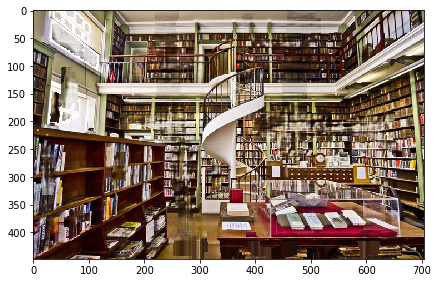

Iter # 1300 , PSRN NOISY:  10.87242977082412 ; PSRN GT:  19.127427974160664


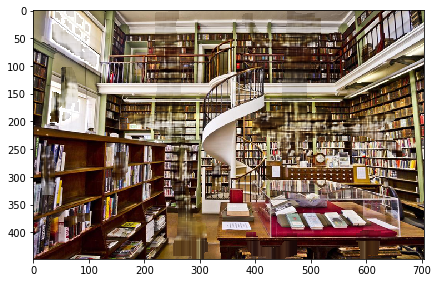

Iter # 1320 , PSRN NOISY:  10.937723991399393 ; PSRN GT:  19.430360871851974


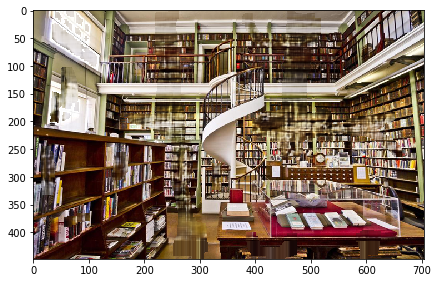

Iter # 1340 , PSRN NOISY:  11.172719340360246 ; PSRN GT:  19.297707651508148


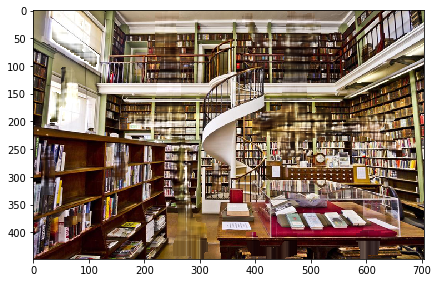

Iter # 1360 , PSRN NOISY:  10.974501214922727 ; PSRN GT:  18.463314141546775


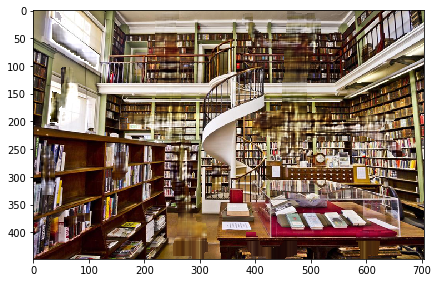

Iter # 1380 , PSRN NOISY:  10.858927675507005 ; PSRN GT:  18.75490521575287


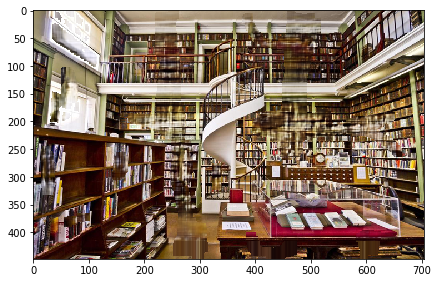

Iter # 1400 , PSRN NOISY:  10.936197241763562 ; PSRN GT:  19.37969905900446


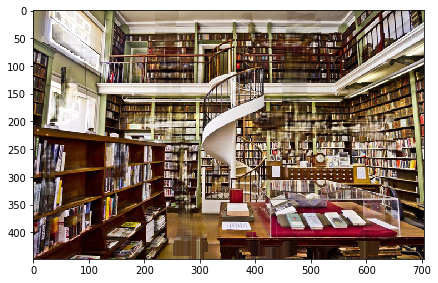

Iter # 1420 , PSRN NOISY:  11.049905030043252 ; PSRN GT:  19.419930111167993


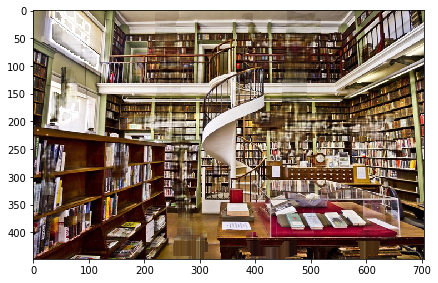

Iter # 1440 , PSRN NOISY:  11.20561299464222 ; PSRN GT:  19.71832883578007


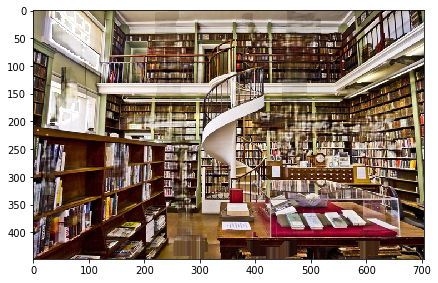

Iter # 1460 , PSRN NOISY:  11.123248524460008 ; PSRN GT:  19.947192605791752


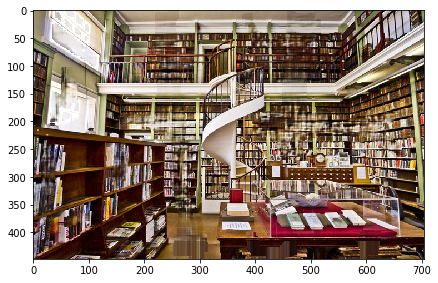

Iter # 1480 , PSRN NOISY:  11.171748775056363 ; PSRN GT:  20.010045635252908


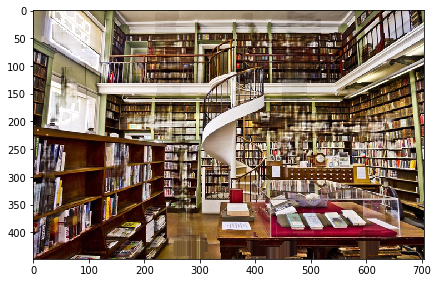

Iter # 1500 , PSRN NOISY:  11.103984053667029 ; PSRN GT:  20.113311731416523


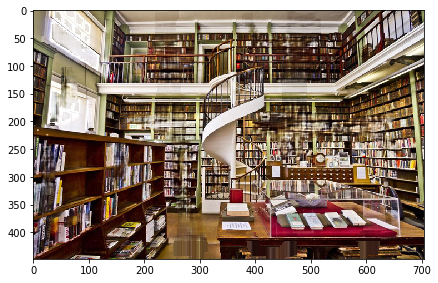

KeyboardInterrupt: 

In [14]:
for i in range(2000):
    model.train_on_batch([input_meshgrid[None, :, :, :], masked_image[None, :, :, :], mask_image[None, :, :, None]], np.zeros((1, height, width)))
    
    if i % 20 == 0:
        inpainted_image = np.clip(base_model.predict(input_meshgrid[None, :, :, :])[0], 0, 255).astype(np.uint8)
        out = (masked_image * mask_image[:, :, None] + inpainted_image * (1 - mask_image[:, :, None])).astype(np.uint8)
        cv2.imwrite("v3_inp_library_inpainted_image_"+str(i)+".png", inpainted_image)
        cv2.imwrite("v3_inp_library_out_"+str(i)+".png", out)
        
        psrn_noisy = compare_psnr(masked_image, out) 
        psrn_gt = compare_psnr(image, out)
        print("Iter #", i, ", PSRN NOISY: ", psrn_noisy, "; PSRN GT: ", psrn_gt)
        
        plt.figure(figsize=(7, 7))
        plt.imshow(out[:,:,::-1])
        plt.show()



In [15]:
model.save("model_inp_library.h5")
base_model.save("base_model_inp_library.h5")